In [35]:
import loompy
import glob
import velocyto as vcy
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pprint
from matplotlib import gridspec

In [36]:
#vlm = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831_tsne33_velocity.hdf5')
#vlm = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831-labels_tsne53_velocity.hdf5')


#vlm_100_22 = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831-labels_kNN100_tsne22.hdf5')
vlm_100_53 = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831-labels_kNN100_tsne53.hdf5')
#vlm_100_33 = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831-labels_kNN100_tsne33.hdf5')
#vlm_100_11 = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831-labels_kNN100_tsne11.hdf5')
#vlm_100_umap = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831-labels_kNN100_umap.hdf5')
vlm_100_1 = vcy.load_velocyto_hdf5('../output/velocyto/10x-180831_kNN100_tsne1.hdf5')


/tools/anaconda/3-4.4.0/lib/python3.6/site-packages/sklearn/base.py:311: UserWarning: Trying to unpickle estimator PCA from version 0.19.1 when using version 0.19.2. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


In [39]:
#print(vlm.S.sum(0))
#vlm.S.sum(0).mean()
#print(vlm_100_22.ts)
print(3)

3


In [44]:
metadata = pd.read_table('../tables/10x-180831-metadata.txt', sep='\t')
metadata

,nGene,nUMI,orig.ident,timepoint,time_combined,percent.mito,res.0.5,res.0.7,res.1,res.1.5,...,State.PC2,Pseudotime,pc2.groups,pc1,pc2_supra_peri,pc2_subq_visce,pc2,pc3,pc4,pc5
AAACCTGAGTCCTCCT-1,4614,23660,SeuratProject,T1,1,0.026627,7,6,8,8,...,3,1.073875,middle,-6.187852,other,other,3.331293,-3.359013,-1.964445,11.317299
AAACCTGCACAGGTTT-1,3584,15599,SeuratProject,T1,1,0.023078,7,6,11,13,...,3,1.370154,middle,-7.702770,other,other,3.330828,-2.502859,-1.644394,9.496364
AAACGGGAGGCTCTTA-1,2979,13379,SeuratProject,T1,1,0.042679,2,2,13,15,...,3,11.151146,middle,-3.819590,other,other,1.676458,-1.378066,-2.576129,-1.121668
AAAGATGAGCTGGAAC-1,3051,11689,SeuratProject,T1,1,0.023783,7,6,11,13,...,3,2.181324,middle,-7.007155,other,other,1.384685,-0.724455,-3.301535,7.278057
AAAGCAACACTTACGA-1,4084,18077,SeuratProject,T1,1,0.028047,7,6,11,13,...,3,0.977370,top_10%_pc2,-7.175428,other,other,3.984249,-1.570916,-0.757836,12.493582
AAAGCAACATTACGAC-1,3351,14168,SeuratProject,T1,1,0.023433,7,6,11,13,...,3,1.684728,middle,-6.660403,other,other,2.604759,-1.587643,-0.442100,8.807820
AAAGCAAGTCGCATAT-1,3139,15634,SeuratProject,T1,1,0.026289,2,2,13,15,...,3,5.001055,middle,-6.228567,other,other,1.064484,-0.750606,-3.455374,-4.049732
AAAGTAGCAAGGACTG-1,5115,30228,SeuratProject,T1,1,0.032817,7,6,11,13,...,3,1.498151,middle,-7.605854,other,other,3.213313,-1.696549,0.135851,7.971162
AAAGTAGGTCCTCTTG-1,3585,17739,SeuratProject,T1,1,0.028919,3,3,0,18,...,3,2.703138,middle,-6.640462,other,other,2.416380,0.161546,4.061603,-1.567421
AAAGTAGGTTCGTCTC-1,4745,23365,SeuratProject,T1,1,0.029531,7,6,11,13,...,3,0.588042,top_10%_pc2,-6.827997,other,other,3.645905,-1.741506,0.570964,12.210855


In [45]:
metadata['CellID'] = metadata.index
ca_df = pd.DataFrame(vlm_100_1.ca)
print('ca', ca_df.shape)
print('metadata', metadata.shape)

ca (23309, 141)
metadata (23428, 58)


In [46]:
merged = ca_df.merge(metadata, on='CellID', how='left')
print(merged.shape)

(23309, 198)


In [47]:
merged = merged.to_dict('list')

/tools/anaconda/3-4.4.0/lib/python3.6/site-packages/ipykernel/__main__.py:1: UserWarning: DataFrame columns are not unique, some columns will be omitted.
  if __name__ == '__main__':


In [48]:
for key in merged:
    
    try:
        vlm_100_1.ca[key] = np.asarray([x.encode('utf8') for x in merged[key]])
    except:
        vlm_100_1.ca[key] = np.asarray(merged[key])

In [73]:
vlm_dict = {'vlm_100_1': vlm_100_1}
#vlm_dict = {'vlm_100_1': vlm_100_1, 'vlm_100_22': vlm_100_22, 'vlm_100_53':vlm_100_53, 'vlm_100_33': vlm_100_33, 'vlm_100_11': vlm_100_11, 'vlm_100_umap': vlm_100_umap}


In [74]:
for vlm in vlm_dict:
    vlm_dict[vlm].ca['CellID'] = [x.decode('utf8') for x in vlm_dict[vlm].ca['CellID']]
    vlm_dict[vlm].ca['timepoint'] = [x.decode('utf8') for x in vlm_dict[vlm].ca['timepoint']]
    vlm_dict[vlm].ca['sample_name_y'] = [x.decode('utf8') for x in vlm_dict[vlm].ca['sample_name_y']]
    vlm_dict[vlm].ca['type'] = [x.decode('utf8') for x in vlm_dict[vlm].ca['type']]

In [8]:
#vlm.set_clusters(vlm.ca['timepoint'])

In [32]:
#vlm.plot_fractions()
#vlm_dict['vlm_100_22'].ca['CellID'] = [x.decode('utf8') for x in vlm_dict['vlm_100_umap'].ca['CellID']]
#vlm_dict['vlm_100_22'].ca['timepoint'] = [x.decode('utf8') for x in vlm_dict['vlm_100_umap'].ca['timepoint']]
#vlm_dict['vlm_100_22'].ca['sample_name_y'] = [x.decode('utf8') for x in vlm_dict['vlm_100_umap'].ca['sample_name_y']]
#vlm_dict['vlm_100_22'].ca['type'] = [x.decode('utf8') for x in vlm_dict['vlm_100_umap'].ca['type']]


AttributeError: 'str' object has no attribute 'decode'

In [75]:
timepoint_colors = {"T1": np.array([246,119,112]), "T2": np.array([163,164,32]), "T3": np.array([29,190,127]), "T4": np.array([30,177,243]), "T5": np.array([229,112,240])}
timepoint_colors = {k:v/256 for k, v in timepoint_colors.items()}

res05_colors = {0: np.array([246,119,112]), 1: np.array([220,139,33]), 10: np.array([182,158,33]), 11: np.array([125,172,32]), 2: np.array([27,184,64]), 3: np.array([29,191,140]), 4: np.array([31,191,195]), 5: np.array([30,181,237]), 6: np.array([123,172,252]), 7: np.array([198,128,252]), 8: np.array([243,105,225]), 9: np.array([253,103,176])}
res05_colors = {k:v/256 for k, v in res05_colors.items()}

state_colors = {1: np.array([246,119,112]), 3:np.array([193,105,45]), 2: np.array([253,164,40])}
state_colors = {k:v/256 for k, v in state_colors.items()}

state_new_colors = {1: np.array([246,119,112]), 3: np.array([193,105,45]), 2: np.array([253,164,40])}
state_new_colors = {k:v/256 for k, v in state_new_colors.items()}

type_colors = {'brown': np.array([193,105,45]), 'white': np.array([253,164,40])}
type_colors = {k:v/256 for k, v in type_colors.items()}

sample_name_colors = {'Peri_4': np.array([246,119,112]), 'Subq_5': np.array([125,172,31]), 'Supra_5': np.array([31,191,195]), 'Visce_4': np.array([198,128,252])}
sample_name_colors = {k:v/256 for k, v in sample_name_colors.items()}


<h3>PCA</h3>

In [11]:
vlm = vlm_dict['vlm_100_1']
vlm.set_clusters(vlm.ca['timepoint'], cluster_colors_dict=timepoint_colors)
#vlm.set_clusters(vlm.ca['type'], cluster_colors_dict=type_colors)

Text(0,0.5,'PC5')

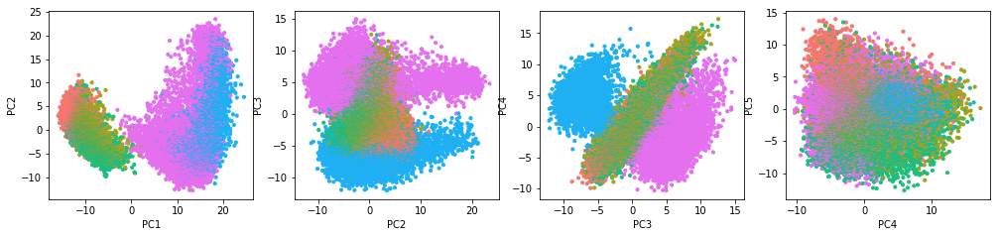

In [12]:
plt.figure(None, (17,3.5))
plt.subplot(141)
vcy.scatter_viz(vlm.pcs[:,0], vlm.pcs[:,1], s=10, c=vlm.colorandum)
plt.xlabel("PC1"); plt.ylabel("PC2")
plt.subplot(142)
vcy.scatter_viz(vlm.pcs[:,1], vlm.pcs[:,2], s=10, c=vlm.colorandum)
plt.xlabel("PC2"); plt.ylabel("PC3")
plt.subplot(143)
vcy.scatter_viz(vlm.pcs[:,2], vlm.pcs[:,3], s=10, c=vlm.colorandum)
plt.xlabel("PC3"); plt.ylabel("PC4")
plt.subplot(144)
vcy.scatter_viz(vlm.pcs[:,3], vlm.pcs[:,4],s=10, c=vlm.colorandum)
plt.xlabel("PC4"); plt.ylabel("PC5")

<h3>RNA velocity</h3>

In [77]:
print(1)

1


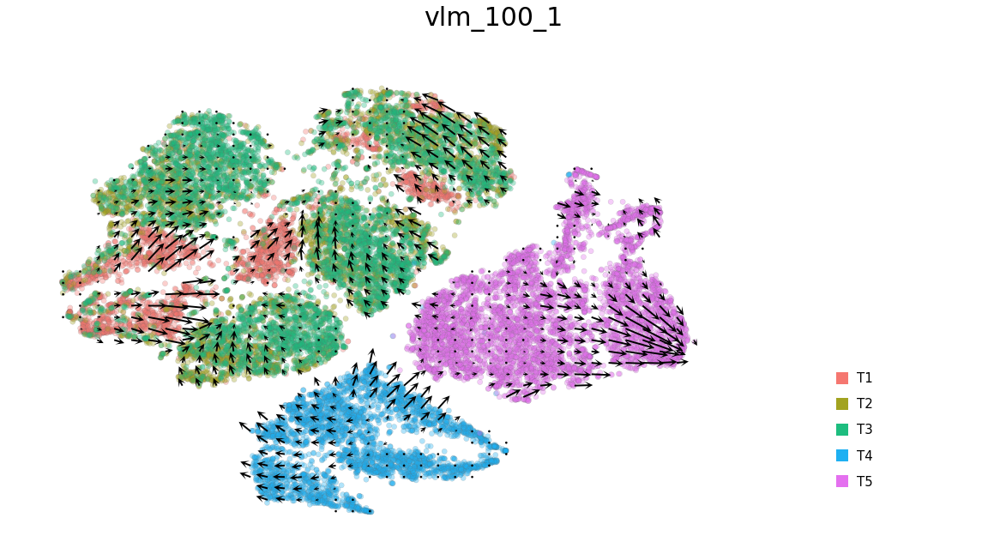

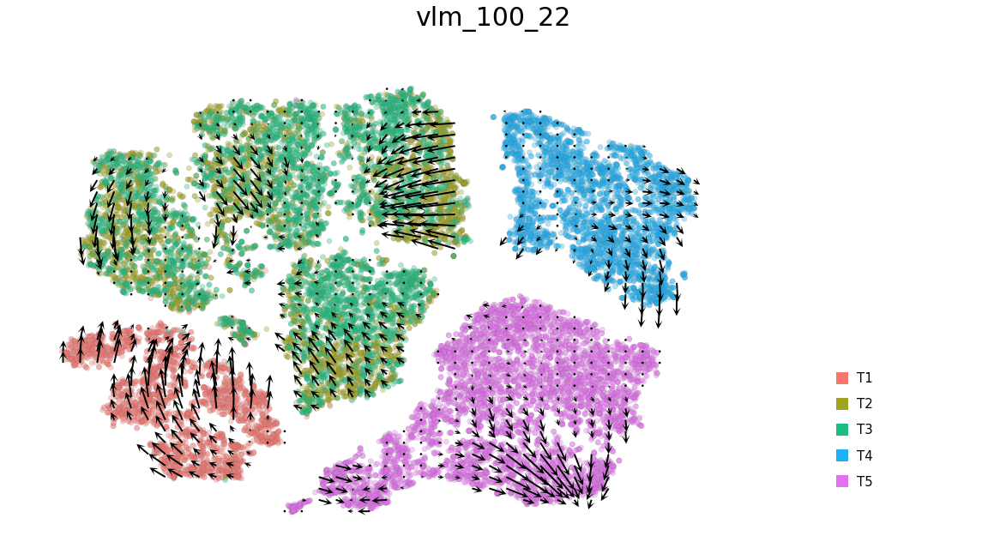

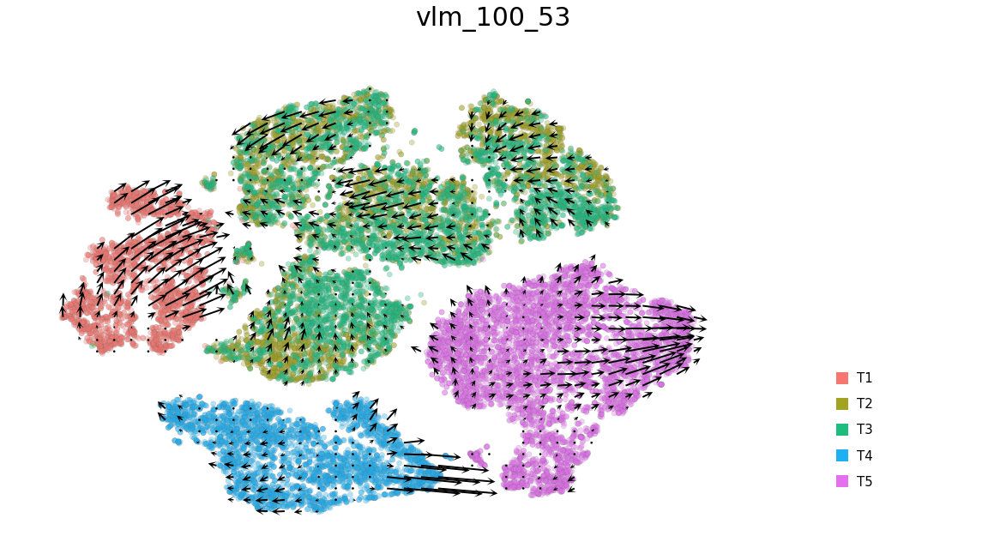

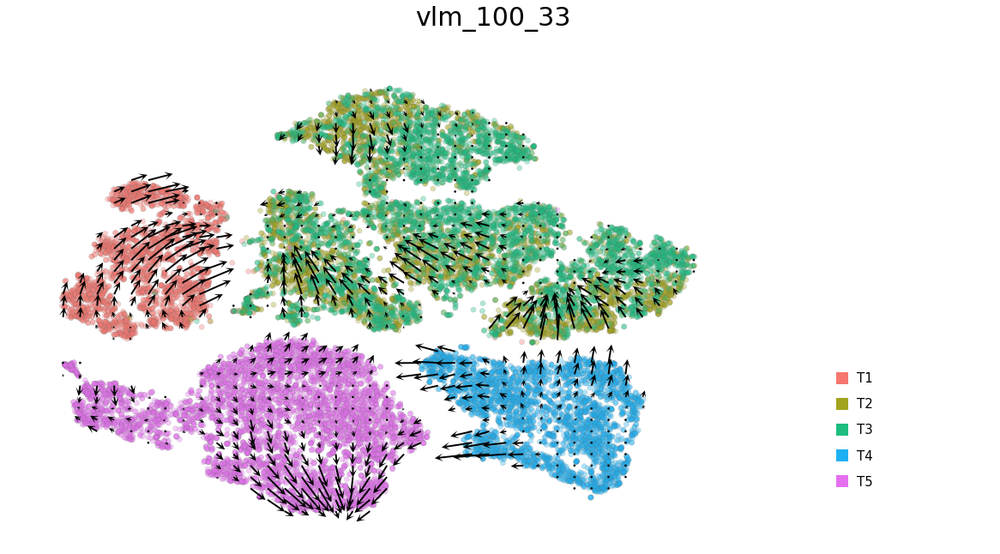

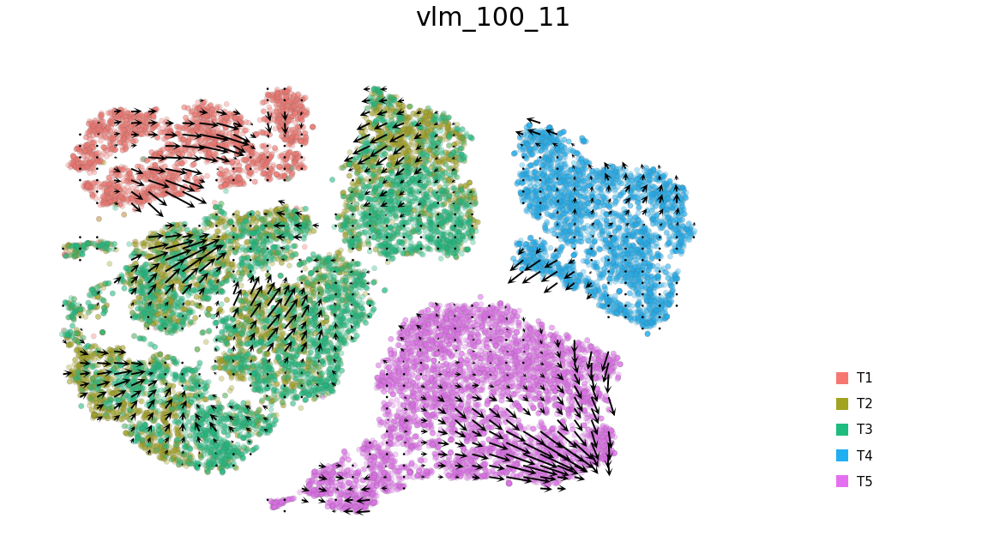

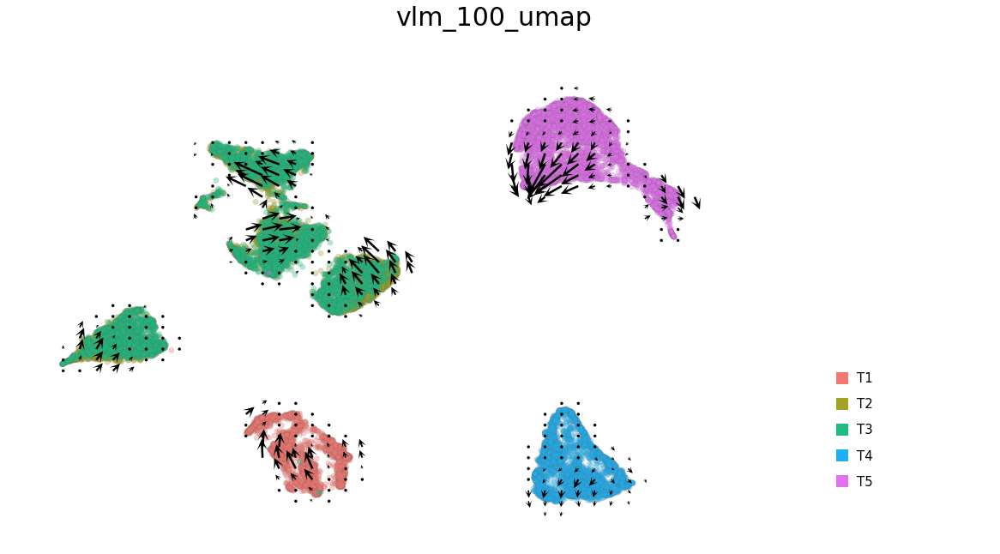

In [76]:
for x in vlm_dict:
    vlm = vlm_dict[x]
    vlm.set_clusters(vlm.ca['timepoint'], timepoint_colors)
    plt.figure(None,(20,10))
    plt.suptitle(x, fontsize=30)
    gs = gridspec.GridSpec(1, 2, width_ratios=[4, 1]) 
    plt.subplot(gs[0])
    vlm.plot_grid_arrows(quiver_scale=3,
                        scatter_kwargs_dict={"alpha":0.35, "lw":0.35, "edgecolor":"0.4", "s":38, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                        headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                        plot_random=False, scale_type="relative")


    colors_dict = {}
    for i in range(len(vlm.colorandum)):
        colors_dict[vlm.ca['timepoint'][i]] = vlm.colorandum[i]

    plt.subplot(gs[1])
    for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
        plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
        plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
    plt.xlim(0.8,2)
    plt.ylim(-1,8)
    plt.axis('off')

    
#plt.subplots(1,2, gridspec_kw = {'width_ratios':[3, 1]})
#plt.savefig('/projects/pytrik/sc_adipose/analyze_10x_fluidigm/data/plots_slides/velocyto.pdf', bbox_inches='tight', pad_inches=0)

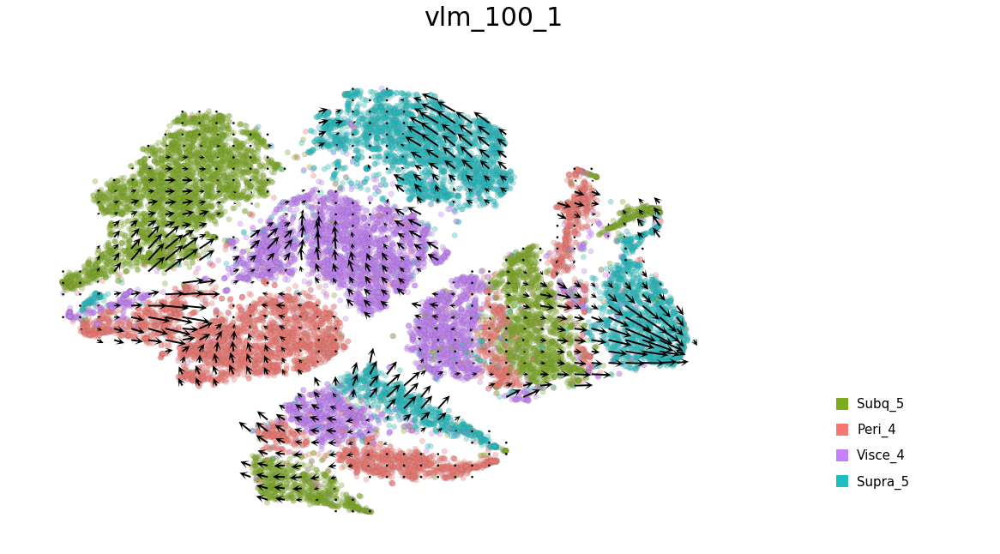

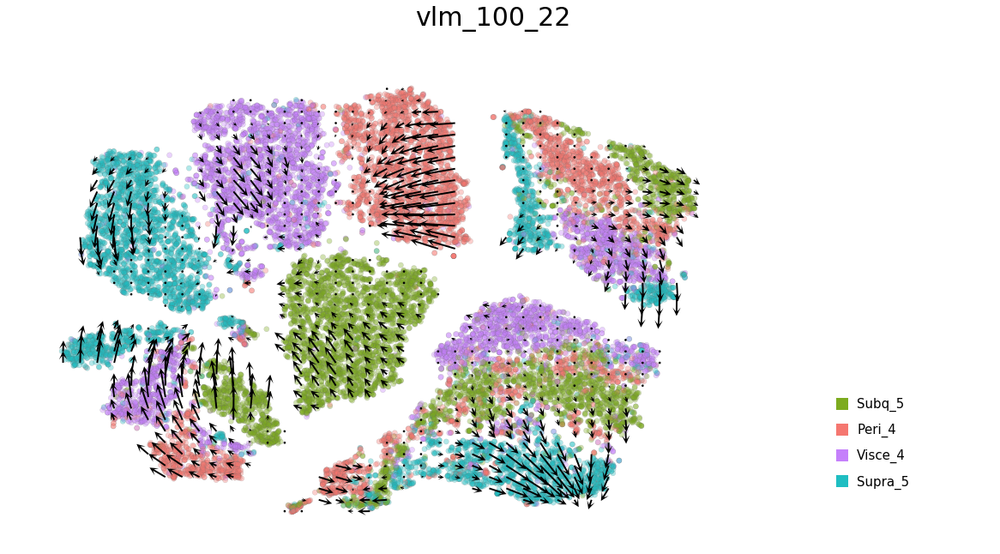

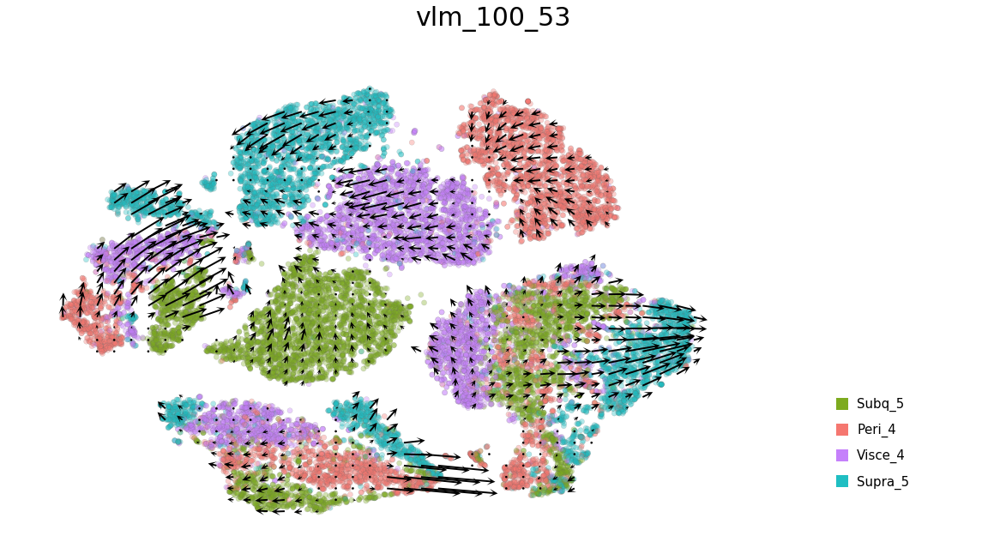

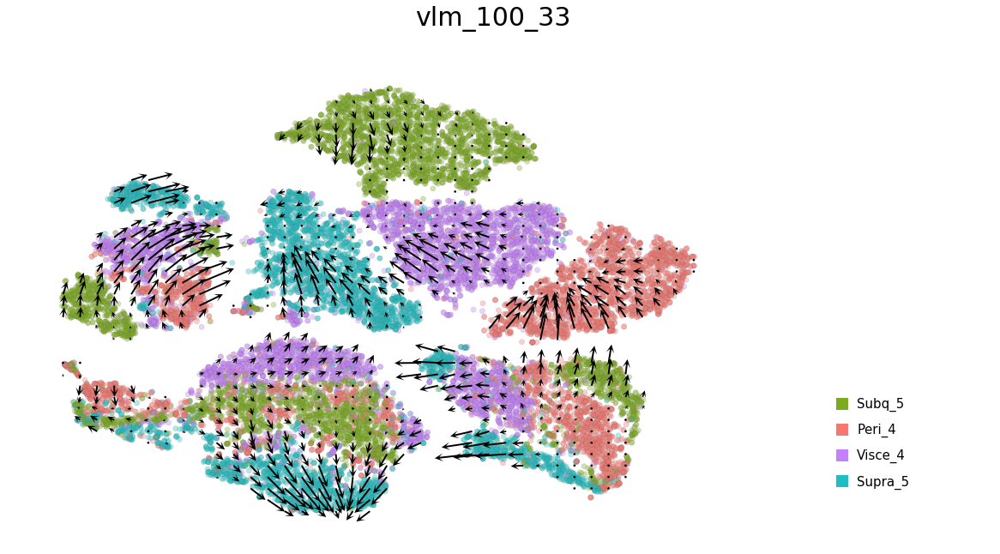

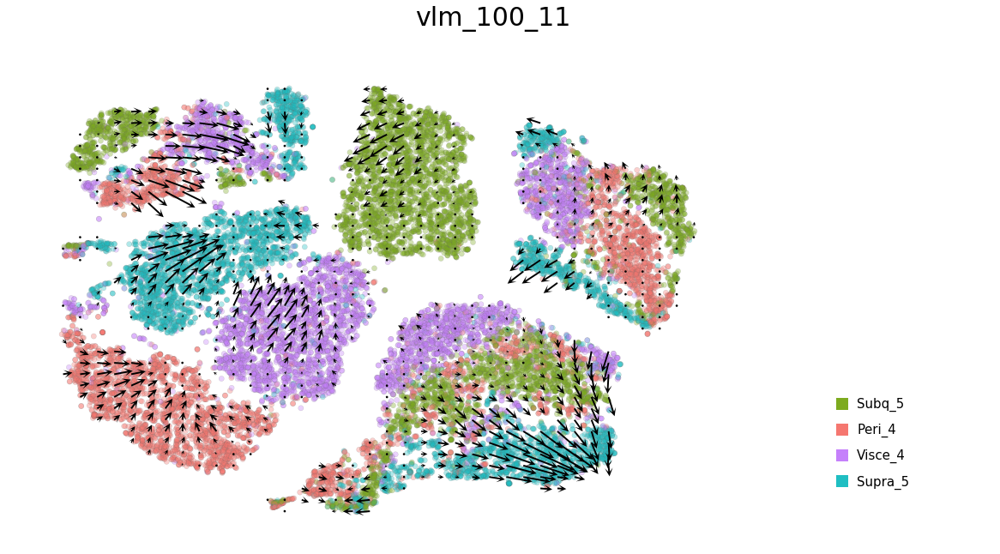

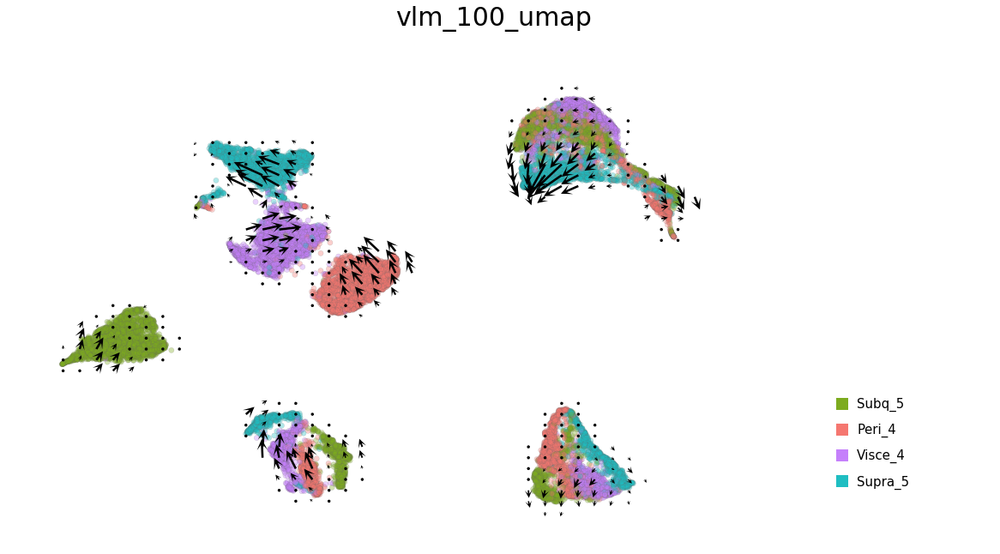

In [44]:
for x in vlm_dict:
    vlm = vlm_dict[x]
    vlm.set_clusters(vlm.ca['sample_name_y'], sample_name_colors)
    plt.figure(None,(20,10))
    plt.suptitle(x, fontsize=30)
    gs = gridspec.GridSpec(1, 2, width_ratios=[4, 1]) 
    plt.subplot(gs[0])
    vlm.plot_grid_arrows(quiver_scale=3,
                        scatter_kwargs_dict={"alpha":0.35, "lw":0.35, "edgecolor":"0.4", "s":38, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                        headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                        plot_random=False, scale_type="relative")


    colors_dict = {}
    for i in range(len(vlm.colorandum)):
        colors_dict[vlm.ca['sample_name_y'][i]] = vlm.colorandum[i]

    plt.subplot(gs[1])
    for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
        plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
        plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
    plt.xlim(0.8,2)
    plt.ylim(-1,8)
    plt.axis('off')

    

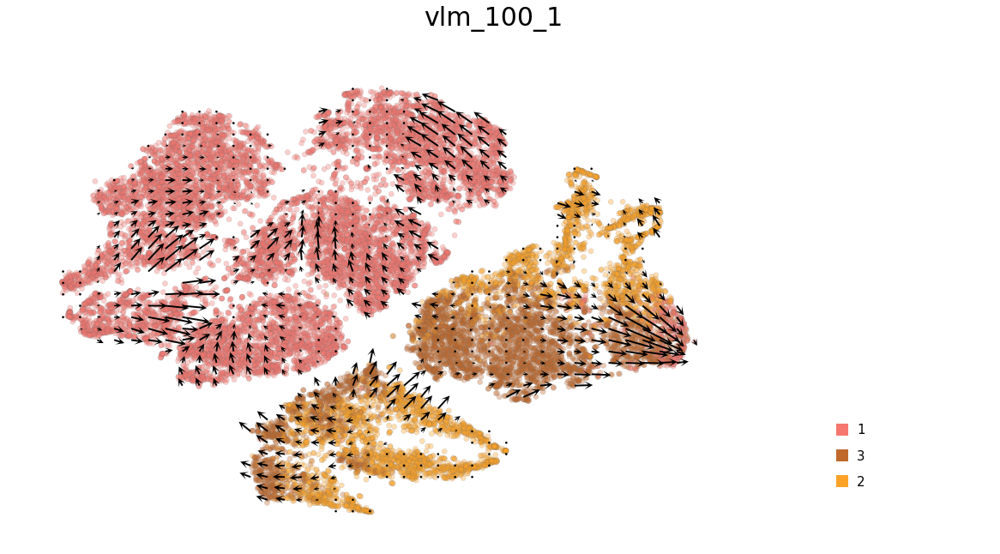

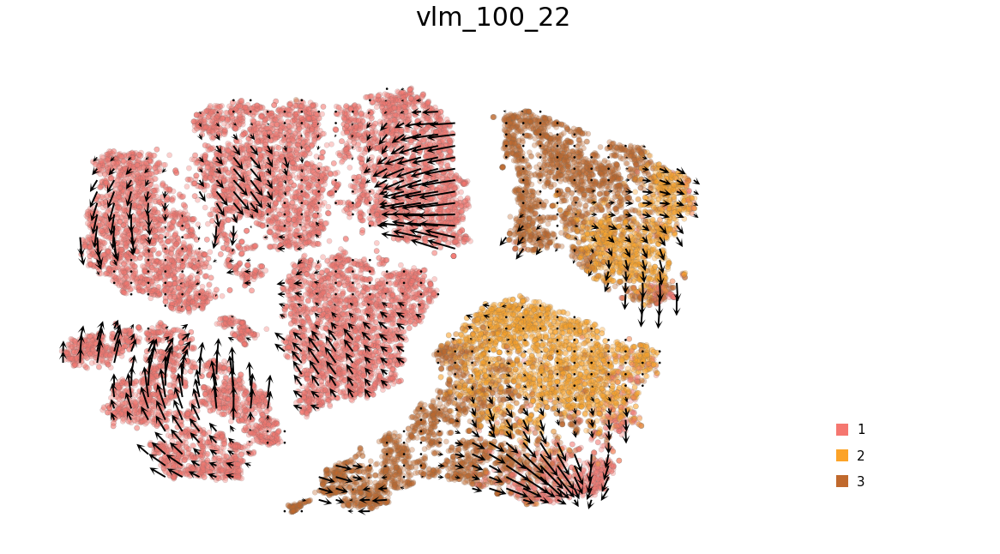

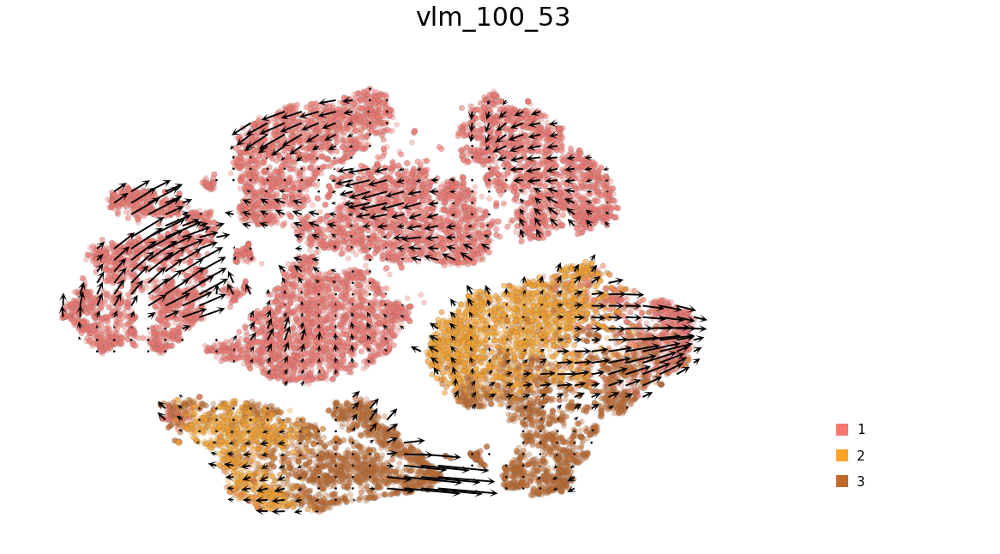

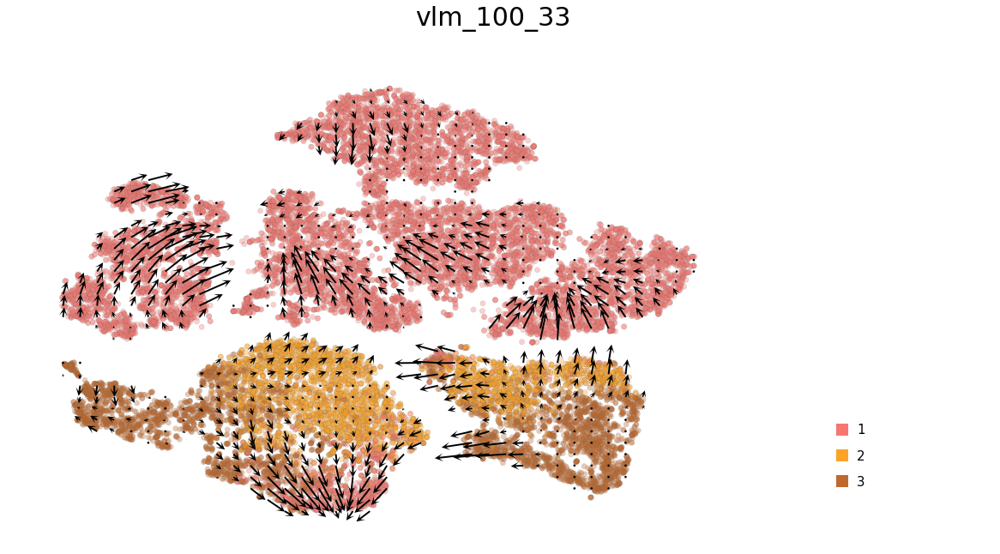

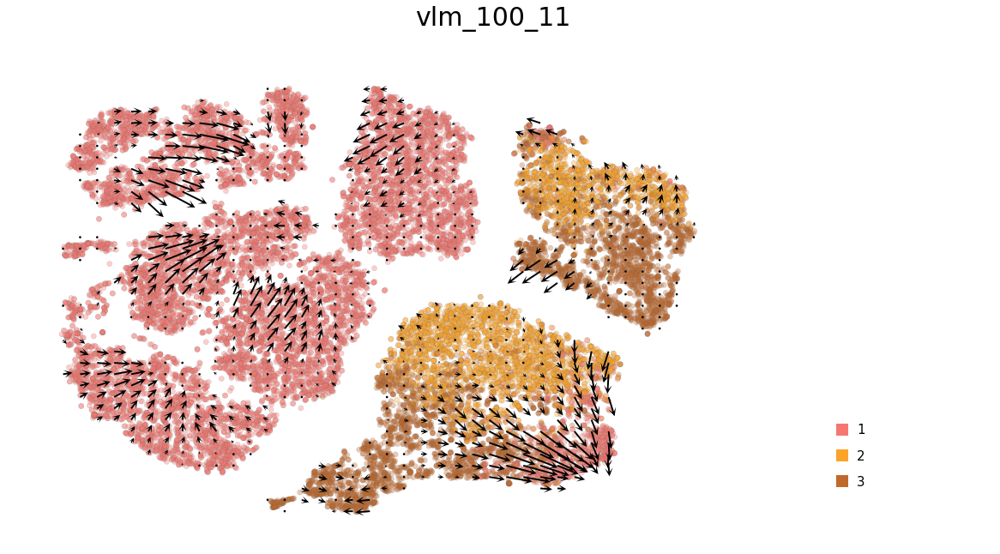

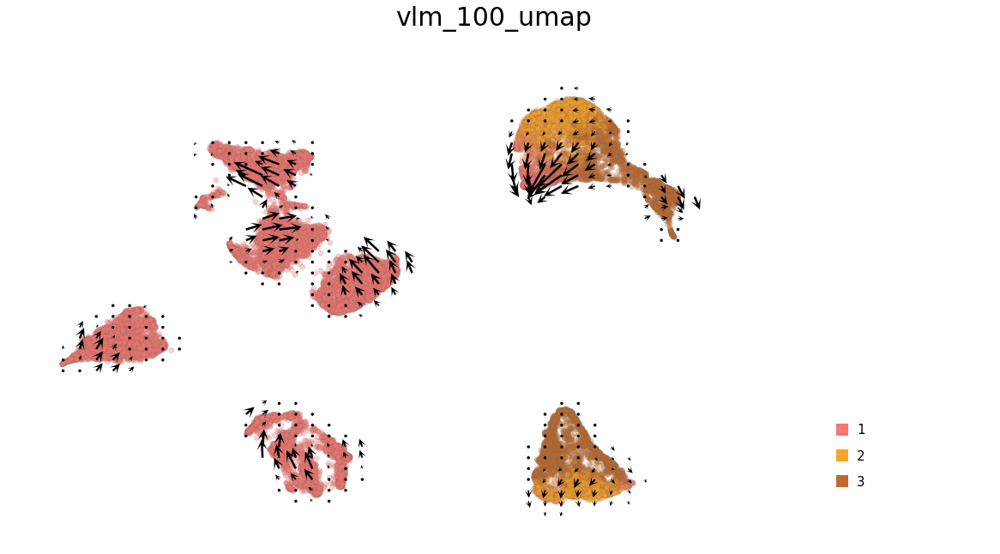

In [45]:
for x in vlm_dict:
    vlm = vlm_dict[x]
    vlm.set_clusters(vlm.ca['State'], state_colors)
    plt.figure(None,(20,10))
    plt.suptitle(x, fontsize=30)
    gs = gridspec.GridSpec(1, 2, width_ratios=[4, 1]) 
    plt.subplot(gs[0])
    vlm.plot_grid_arrows(quiver_scale=3,
                        scatter_kwargs_dict={"alpha":0.35, "lw":0.35, "edgecolor":"0.4", "s":38, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                        headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                        plot_random=False, scale_type="relative")


    colors_dict = {}
    for i in range(len(vlm.colorandum)):
        colors_dict[vlm.ca['State'][i]] = vlm.colorandum[i]

    plt.subplot(gs[1])
    for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
        plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
        plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
    plt.xlim(0.8,2)
    plt.ylim(-1,8)
    plt.axis('off')

    

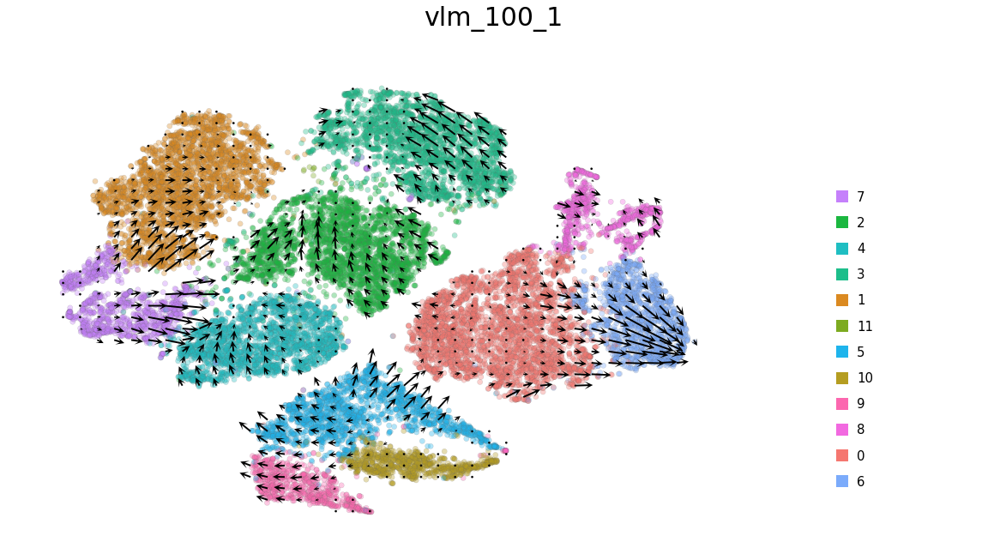

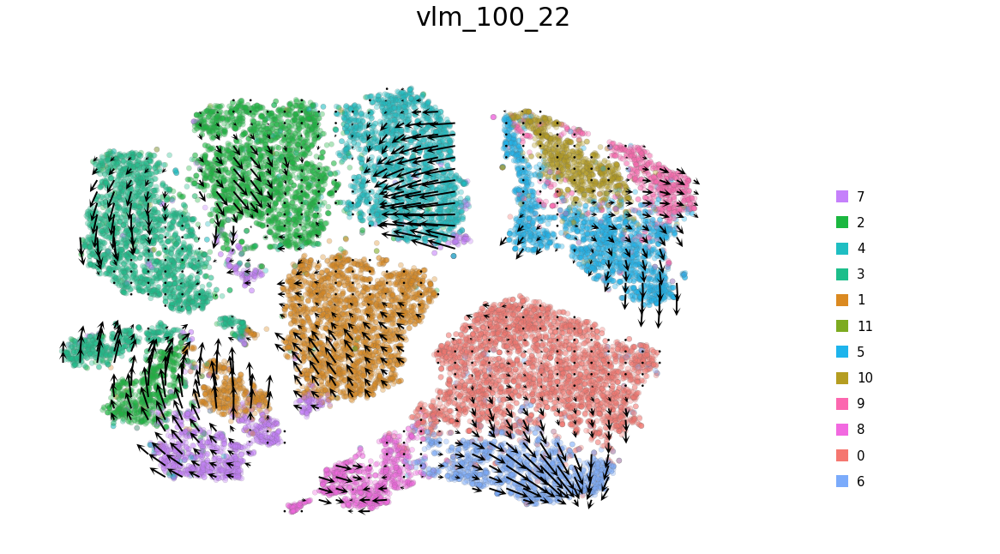

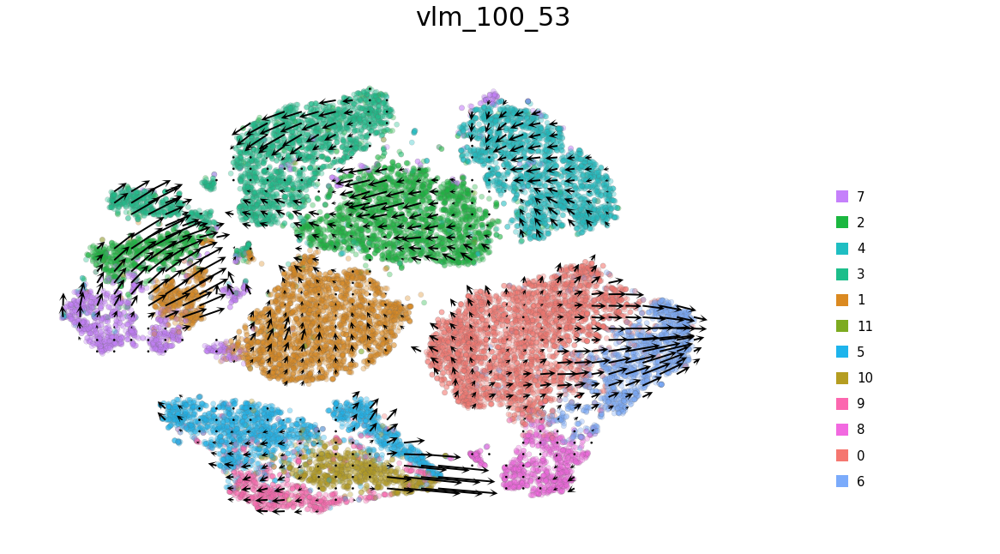

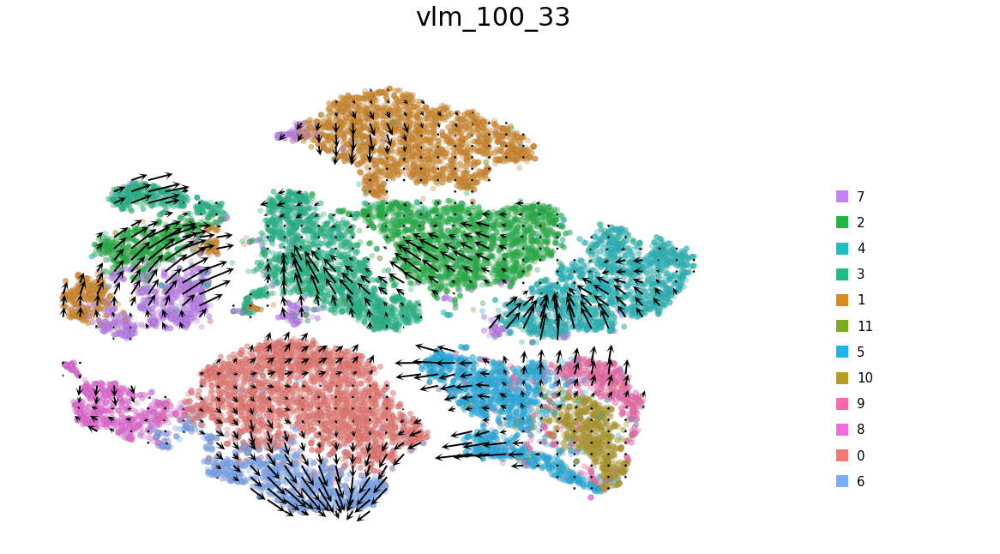

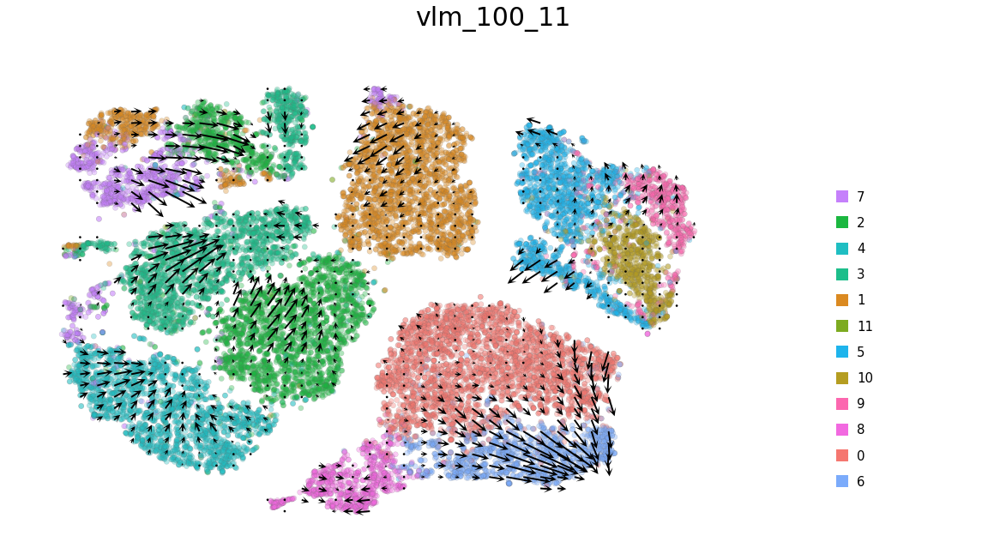

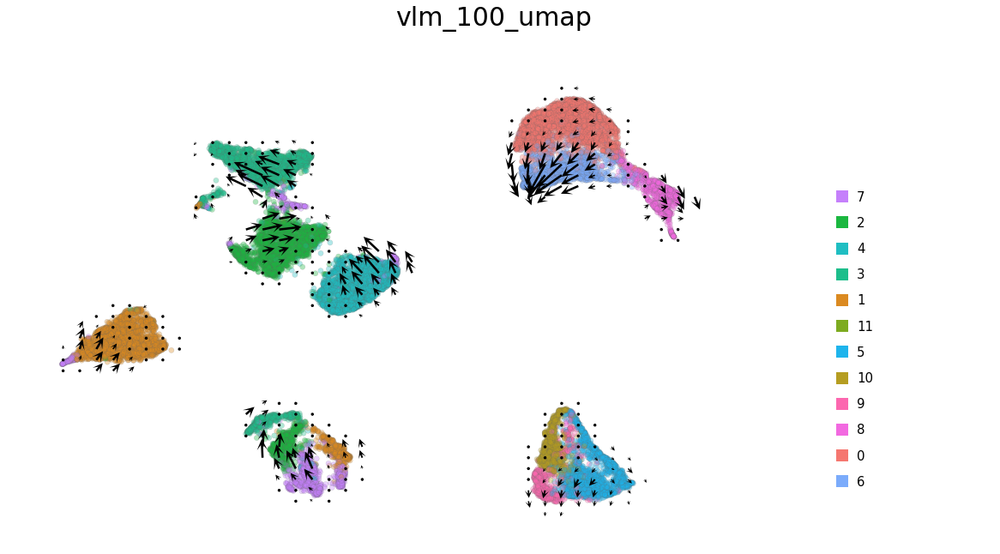

In [48]:
for x in vlm_dict:
    vlm = vlm_dict[x]
    vlm.set_clusters(vlm.ca['res.0.5'], res05_colors)
    plt.figure(None,(20,10))
    plt.suptitle(x, fontsize=30)
    gs = gridspec.GridSpec(1, 2, width_ratios=[4, 1]) 
    plt.subplot(gs[0])
    vlm.plot_grid_arrows(quiver_scale=3,
                        scatter_kwargs_dict={"alpha":0.35, "lw":0.35, "edgecolor":"0.4", "s":38, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                        headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                        plot_random=False, scale_type="relative")


    colors_dict = {}
    for i in range(len(vlm.colorandum)):
        colors_dict[vlm.ca['res.0.5'][i]] = vlm.colorandum[i]

    plt.subplot(gs[1])
    for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
        plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
        plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
    plt.xlim(0.8,2)
    plt.ylim(-1,8)
    plt.axis('off')


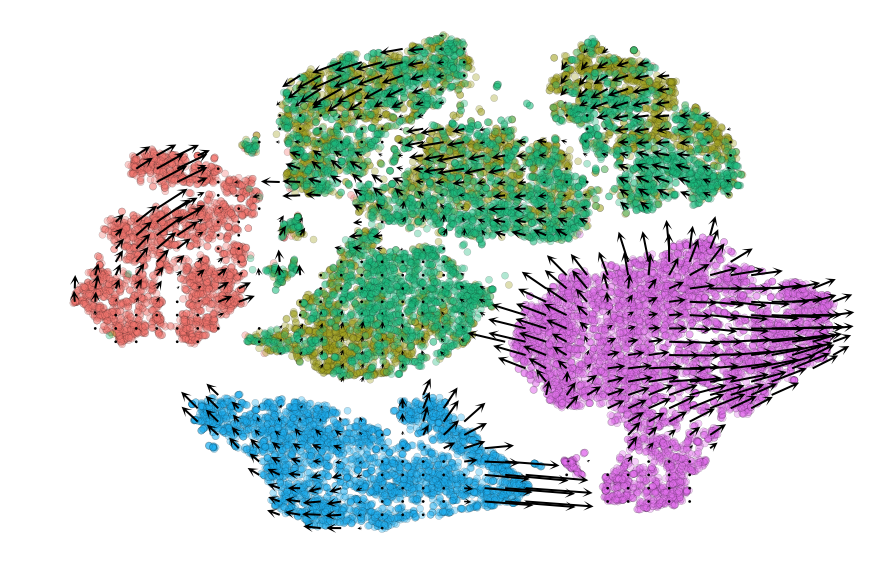

In [119]:
vlm.set_clusters(vlm.ca['timepoint'], timepoint_colors)
plt.figure(None,(15,10))
vlm.plot_grid_arrows(quiver_scale=3.0,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.3, "edgecolor":"0", "s":50, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")
#plt.savefig('/projects/pytrik/sc_adipose/analyze_10x_fluidigm/data/plots_slides/velocyto.pdf', bbox_inches='tight', pad_inches=0)

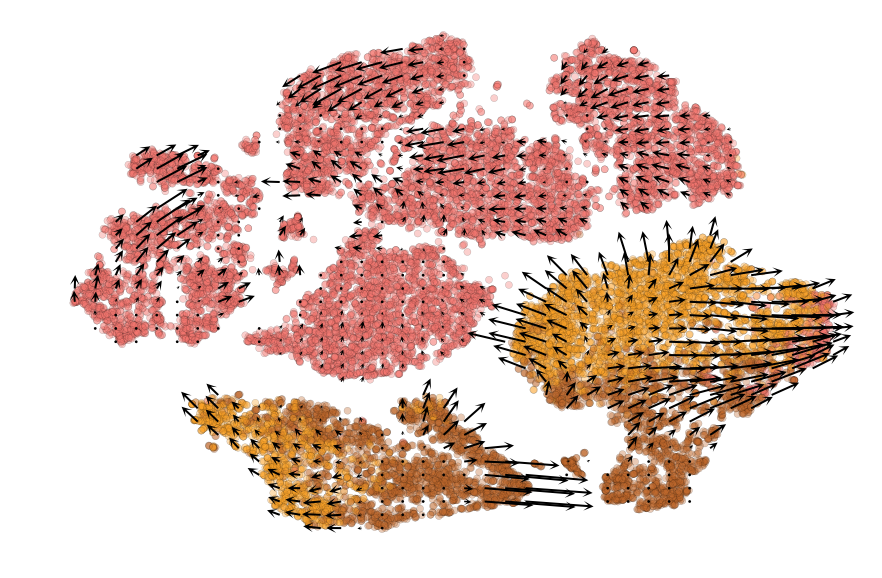

In [120]:
#vlm.set_clusters(vlm.ca['res.0.5'], res05_colors)
vlm.set_clusters(vlm.ca['State.old'], state_colors)
plt.figure(None,(15,10))
vlm.plot_grid_arrows(quiver_scale=3.0,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.3, "edgecolor":"0", "s":50, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")


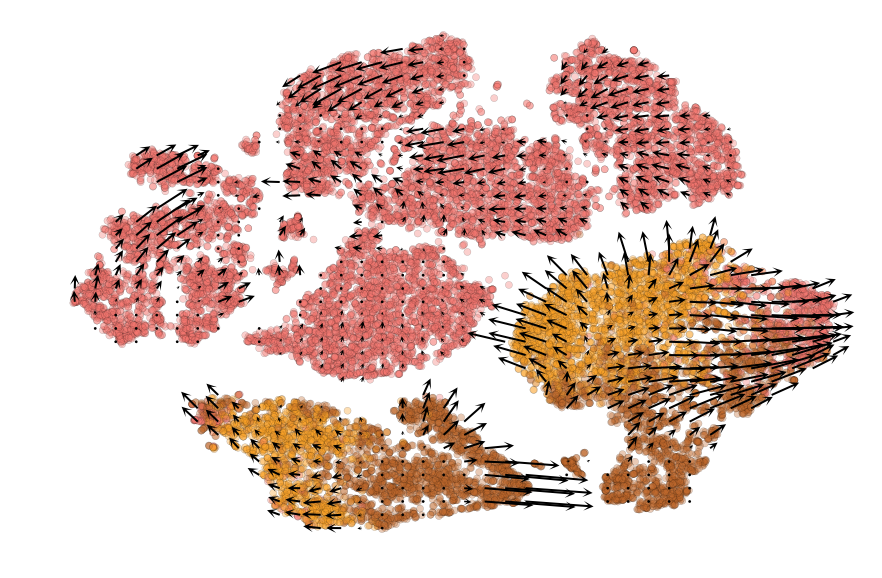

In [121]:
#vlm.set_clusters(vlm.ca['res.0.5'], res05_colors)
vlm.set_clusters(vlm.ca['State'], state_new_colors)
plt.figure(None,(15,10))
vlm.plot_grid_arrows(quiver_scale=3.0,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.3, "edgecolor":"0", "s":50, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")


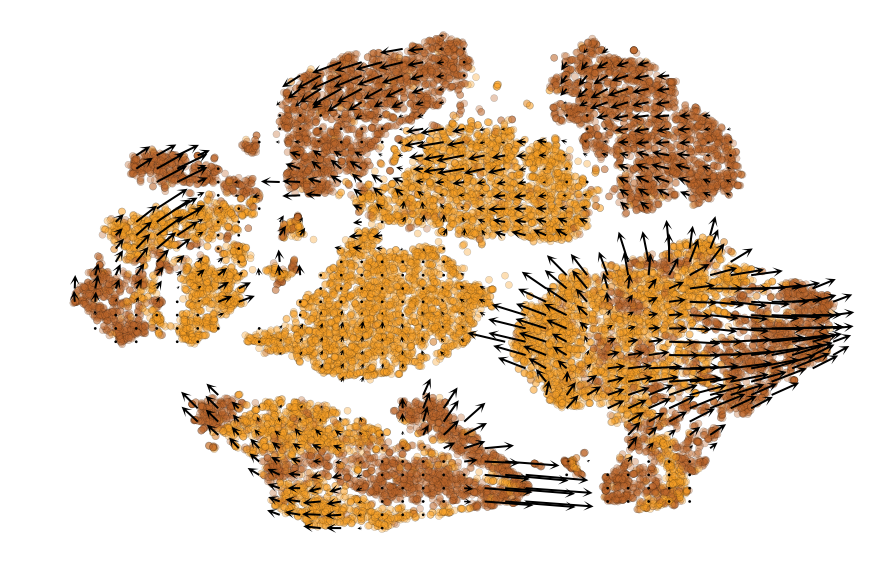

In [122]:
vlm.set_clusters(vlm.ca['type'], type_colors)
plt.figure(None,(15,10))
vlm.plot_grid_arrows(quiver_scale=3.0,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.3, "edgecolor":"0", "s":50, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")

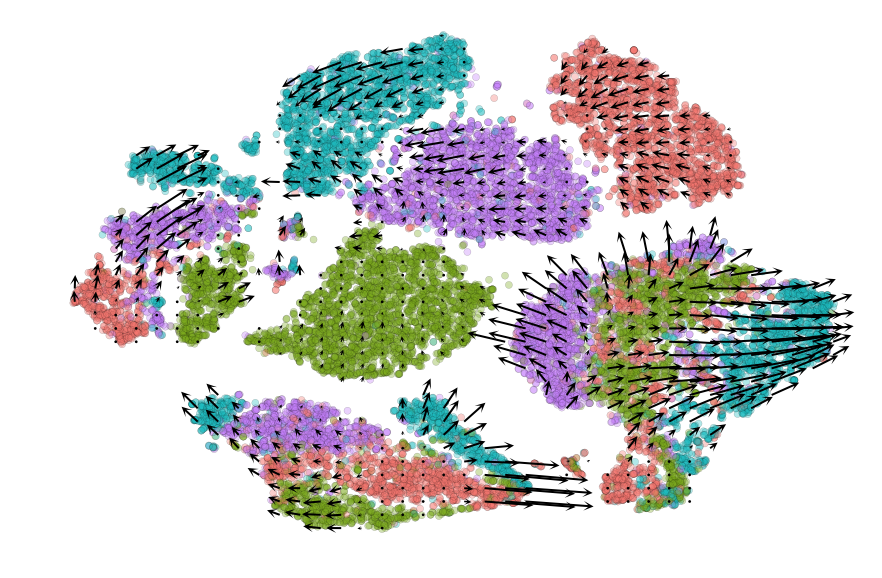

In [124]:
vlm.set_clusters(vlm.ca['sample_name_y'], sample_name_colors)
plt.figure(None,(15,10))
vlm.plot_grid_arrows(quiver_scale=3.0,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.3, "edgecolor":"0", "s":50, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")

(0.8, 2.0, -1.0, 8.0)

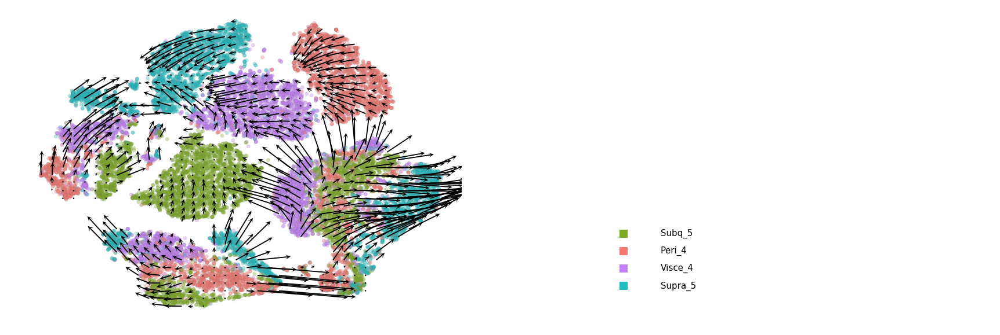

In [125]:
vlm.set_clusters(vlm.ca['sample_name_y'], sample_name_colors)
plt.figure(None,(30,10))
plt.subplot(121)
vlm.plot_grid_arrows(quiver_scale=1.4,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.35, "edgecolor":"0.4", "s":38, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")


colors_dict = {}
for i in range(len(vlm.colorandum)):
    colors_dict[vlm.ca['sample_name_y'][i]] = vlm.colorandum[i]

plt.subplot(122)
for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
    plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
    plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
plt.xlim(0.8,2)
plt.ylim(-1,8)
plt.axis('off')

In [ ]:
vlm.set_clusters(vlm.ca['State'], state_colors)
plt.figure(None,(30,10))
plt.subplot(121)
vlm.plot_grid_arrows(quiver_scale=3,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.35, "edgecolor":"0.4", "s":38, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")


colors_dict = {}
for i in range(len(vlm.colorandum)):
    colors_dict[vlm.ca['State'][i]] = vlm.colorandum[i]

plt.subplot(122)
for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
    plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
    plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
plt.xlim(0.8,2)
plt.ylim(-1,8)
plt.axis('off')

In [ ]:
vlm.set_clusters(vlm.ca['State'], state_colors)
colors_dict = {}
for i in range(len(vlm.colorandum)):
    colors_dict[vlm.ca['State'][i]] = vlm.colorandum[i]
    
plt.figure(None,(15,10))
for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
    plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
    plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
plt.xlim(0.8,2)
plt.ylim(-1,8)
plt.axis('off')
plt.savefig('../plots/180831_velocyto_phase_legend.pdf', bbox_inches='tight')

In [ ]:
vlm.set_clusters(vlm.ca['timepoint'], timepoint_colors)
colors_dict = {}
for i in range(len(vlm.colorandum)):
    colors_dict[vlm.ca['timepoint'][i]] = vlm.colorandum[i]
    
plt.figure(None,(15,10))
for zz, (k, v) in enumerate(list(colors_dict.items())[::-1]):
    plt.scatter(1, zz/2., c=v, marker="s", lw=0., edgecolor="k", s=220)
    plt.text(1.1, zz/2., k, fontdict={"va":"center", "size":15})
plt.xlim(0.8,2)
plt.ylim(-1,8)
plt.axis('off')
plt.savefig('../plots/180831_velocyto_timepoint_legend.pdf', bbox_inches='tight')

In [ ]:
vlm.set_clusters(vlm.ca['State'], state_colors)
plt.figure(None,(45,30))
vlm.plot_grid_arrows(quiver_scale=3.0,
                    scatter_kwargs_dict={"alpha":0.35, "lw":2, "edgecolor":"0.4", "s":400, "rasterized":True}, min_mass=5.5, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=False, scale_type="relative")
plt.savefig('../plots/180831_velocyto_state.pdf', bbox_inches='tight', pad_inches=0)

<h3>Phase portraits</h3>


In [49]:
vlm = vlm_dict['vlm_100_1']

In [51]:

# plotting utility functions
def despline():
    ax1 = plt.gca()
    # Hide the right and top spines
    ax1.spines['right'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    # Only show ticks on the left and bottom spines
    ax1.yaxis.set_ticks_position('left')
    ax1.xaxis.set_ticks_position('bottom')
    
def minimal_xticks(start, end):
    end_ = np.around(end, -int(np.log10(end))+1)
    xlims = np.linspace(start, end_, 5)
    xlims_tx = [""]*len(xlims)
    xlims_tx[0], xlims_tx[-1] = f"{xlims[0]:.0f}", f"{xlims[-1]:.02f}"
    plt.xticks(xlims, xlims_tx)

    
def minimal_yticks(start, end):
    end_ = np.around(end, -int(np.log10(end))+1)
    ylims = np.linspace(start, end_, 5)
    ylims_tx = [""]*len(ylims)
    ylims_tx[0], ylims_tx[-1] = f"{ylims[0]:.0f}", f"{ylims[-1]:.02f}"
    plt.yticks(ylims, ylims_tx)

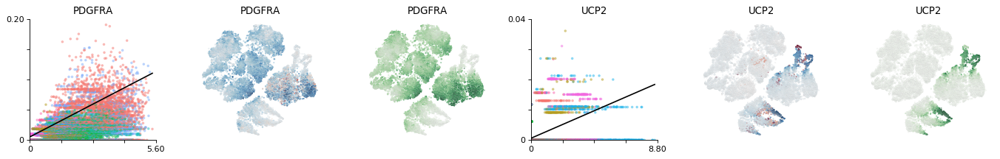

In [54]:
plt.figure(None, (17,2.8), dpi=80)
gs = plt.GridSpec(1,6)
for i, gn in enumerate(["PDGFRA","UCP2"]):
    ax = plt.subplot(gs[i*3])
    try:
        ix=np.where(vlm.ra["Gene"] == gn)[0][0]
    except:
        continue
    vcy.scatter_viz(vlm.Sx_sz[ix,:], vlm.Ux_sz[ix,:], c=vlm.colorandum, s=5, alpha=0.4, rasterized=True)
    plt.title(gn)
    xnew = np.linspace(0,vlm.Sx[ix,:].max())
    plt.plot(xnew, vlm.gammas[ix] * xnew + vlm.q[ix], c="k")
    plt.ylim(0, np.max(vlm.Ux_sz[ix,:])*1.02)
    plt.xlim(0, np.max(vlm.Sx_sz[ix,:])*1.02)
    minimal_yticks(0, np.max(vlm.Ux_sz[ix,:])*1.02)
    minimal_xticks(0, np.max(vlm.Sx_sz[ix,:])*1.02)
    despline()
    
    vlm.plot_velocity_as_color(gene_name=gn, gs=gs[i*3+1], s=3, rasterized=True)

    vlm.plot_expression_as_color(gene_name=gn, gs=gs[i*3+2], s=3, rasterized=True)
    
plt.tight_layout()

<h3>Velocity per cell</h3>

In [79]:
vlm = vlm_dict['vlm_100_53']

In [78]:
vlm.set_clusters(vlm.ca['State'], state_colors)

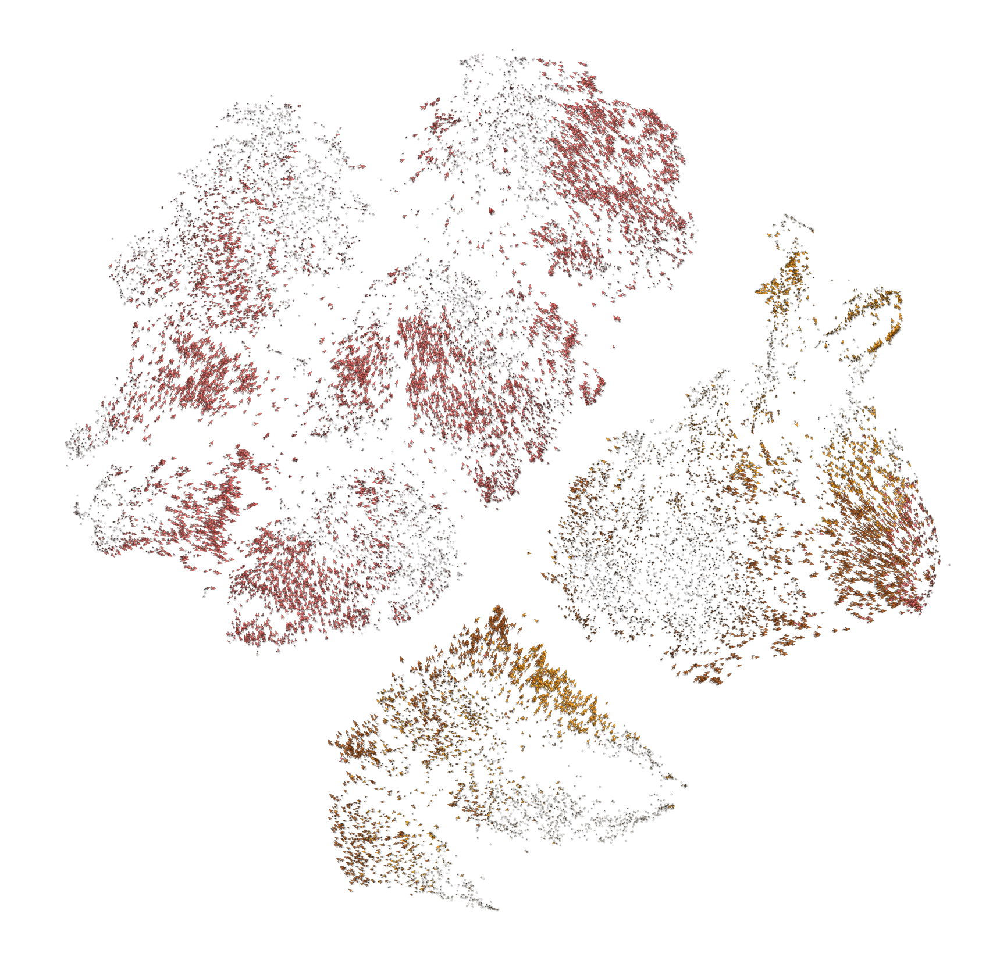

In [63]:
plt.figure(None,(30,30))
quiver_scale = 60

plt.scatter(vlm.embedding[:, 0], vlm.embedding[:, 1],
            c="0.8", alpha=0.2, s=10, edgecolor="")

ix_choice = np.random.choice(vlm.embedding.shape[0], size=int(vlm.embedding.shape[0]/1.), replace=False)
plt.scatter(vlm.embedding[ix_choice, 0], vlm.embedding[ix_choice, 1],
            c="0.8", alpha=0.4, s=10, edgecolor=(0,0,0,1), lw=0.3, rasterized=True)

quiver_kwargs=dict(headaxislength=7, headlength=11, headwidth=8,linewidths=0.25, width=0.00045,edgecolors="k", color=vlm.colorandum[ix_choice], alpha=1)
plt.quiver(vlm.embedding[ix_choice, 0], vlm.embedding[ix_choice, 1],
           vlm.delta_embedding[ix_choice, 0], vlm.delta_embedding[ix_choice, 1],
           scale=quiver_scale, **quiver_kwargs)

plt.axis("off")
plt.savefig("../plots/180831_velocyto_full_arrows_vlm-100-53.pdf")

In [ ]:
plt.figure(None,(30,30))
quiver_scale = 60

plt.scatter(vlm.embedding[:, 0], vlm.embedding[:, 1],
            c="0.8", alpha=0.2, s=10, edgecolor="")

ix_choice = np.random.choice(vlm.embedding.shape[0], size=int(vlm.embedding.shape[0]/1.), replace=False)
plt.scatter(vlm.embedding[ix_choice, 0], vlm.embedding[ix_choice, 1],
            c="0.8", alpha=0.4, s=10, edgecolor=(0,0,0,1), lw=0.3, rasterized=True)

quiver_kwargs=dict(headaxislength=7, headlength=11, headwidth=8,linewidths=0.25, width=0.00045,edgecolors="k", color=vlm.colorandum[ix_choice], alpha=1)
plt.quiver(vlm.embedding[ix_choice, 0], vlm.embedding[ix_choice, 1],
           vlm.delta_embedding[ix_choice, 0], vlm.delta_embedding[ix_choice, 1],
           scale=quiver_scale, **quiver_kwargs)

plt.axis("off")
plt.savefig("../plots/180831_velocyto_full_arrows.pdf")